<a href="https://colab.research.google.com/github/AbhilashTUofficial/Jupyter-Notebook/blob/master/OpenCV2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# OpenCV - YouTube Tutorial

### Configurations

In [8]:
!git clone https://github.com/misbah4064/opencvTutorial.git
%cd opencvTutorial/
from IPython.display import clear_output
clear_output()

### Lesson 1

In [9]:

# Lesson 1
# Introduction

import cv2
import numpy as np
from google.colab.patches import cv2_imshow

### Lesson 2

(476, 640, 3)


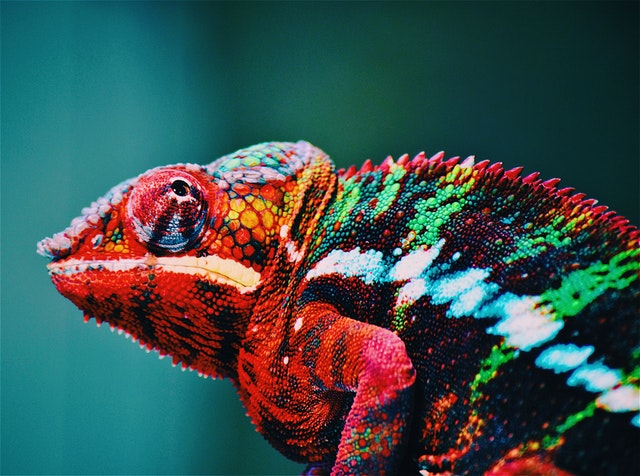

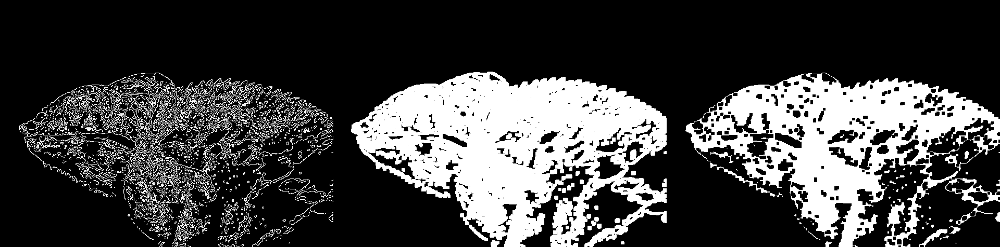

In [10]:

# Lesson 2
# Changing color profiles in an image.

lizardImage=cv2.imread("images/color.jpg");
print(lizardImage.shape);

#Convert to gray-scale image

grayScaleImg=cv2.cvtColor(lizardImage,cv2.COLOR_BGR2GRAY);
hsvImg=cv2.cvtColor(lizardImage,cv2.COLOR_BGR2HSV);
cv2_imshow(lizardImage);
#cv2_imshow(grayScaleImg);
#cv2_imshow(hsvImg);
edgeDetectionImg=cv2.Canny(grayScaleImg,150,200);
#cv2_imshow(edgeDetectionImg);
kernel=np.ones((5,5),np.uint8)

# Dilation

dialatImg=cv2.dilate(edgeDetectionImg,kernel,iterations=1);
#cv2_imshow(dialatImg);

# Erosion

erodeImg=cv2.erode(dialatImg,kernel,iterations=1);
#cv2_imshow(erodeImg);

display=np.hstack((edgeDetectionImg,dialatImg,erodeImg))
cv2_imshow(display);

### Lesson 3

In [ ]:

# Lesson 3
# Image Manipulation.
# Noise Removal.

lionImage=cv2.imread("images/lion.jpg");
denoisedLionImage=cv2.fastNlMeansDenoisingColored(lionImage,None,50,20,7,15);
display=np.hstack((lionImage,denoisedLionImage));
cv2_imshow(display);

### Lesson 4

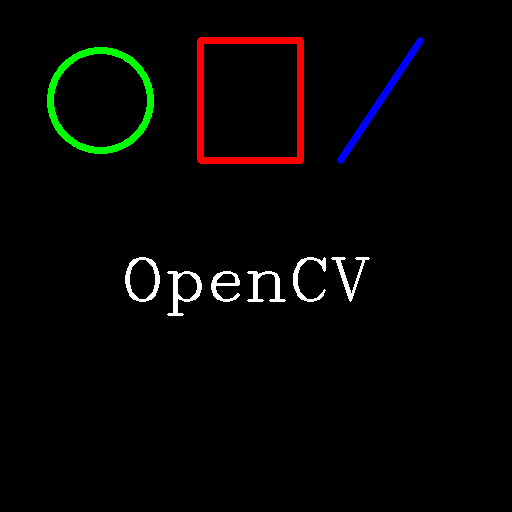

In [12]:

# Lesson 4
# Drawing shapes and writing text on Images.

imageLayer=np.zeros((512,512,3),np.uint8); 
# uint8 -> can have values between 0 to 255

# Drawing Functions

cv2.circle(imageLayer,(100,100),50,(0,255,0),6);
# cv2.circle(image,(x,y),radius,(b,g,r),thickness);
cv2.rectangle(imageLayer,(200,40),(300,160),(0,0,255),6);
# cv2.rectangle(image,(x1,y1),(x2,y2),(b,g,r),thickness);
cv2.line(imageLayer,(340,160),(420,40),(255,0,0),6);
# cv2.line(image,(x1,y1),(x2,y2).(b,g,r),thickness);
cv2.putText(imageLayer,"OpenCV",(120,300),cv2.FONT_HERSHEY_COMPLEX,2,(255,255,255),2);
# cv2.putText(image,"string",(x,y).font-family,font-size,(b,g,r),thickness);

cv2_imshow(imageLayer);

### Exercise 1 - Color Detection

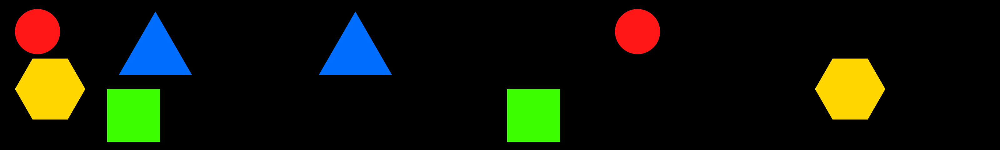

In [ ]:
shapesImage=cv2.imread("images/shapes.png");
hsvShapesImage=cv2.cvtColor(shapesImage,cv2.COLOR_BGR2HSV);

# Defining the bounds of blue color.
# lower bound : 65, upper bound : 110
# background bound : 0,0 to 255,255 (ignore)
lowerBlue=np.array([65,0,0]);
upperBlue=np.array([110,255,255]);

lowerRed=np.array([0,0,0]);
upperRed=np.array([20,255,255]);

lowerGreen=np.array([46,0,0]);
upperGreen=np.array([91,255,255]);

lowerYellow=np.array([21,0,0]);
upperYellow=np.array([45,255,255]);

# cv2.inRange(image,lowerBound,upperBound) return the are where the 
# given range is present
blueColorMask=cv2.inRange(hsvShapesImage,lowerBlue,upperBlue);
redColorMask=cv2.inRange(hsvShapesImage,lowerRed,upperRed);
greenColorMask=cv2.inRange(hsvShapesImage,lowerGreen,upperGreen);
yellowColorMask=cv2.inRange(hsvShapesImage,lowerYellow,upperYellow);


# cv2.bitwise_and(image,image,mask=mask) return a image where only
# the masked area is visible.
blueColorResult=cv2.bitwise_and(shapesImage,shapesImage,mask=blueColorMask);
redColorResult=cv2.bitwise_and(shapesImage,shapesImage,mask=redColorMask);
greenColorResult=cv2.bitwise_and(shapesImage,shapesImage,mask=greenColorMask);
yellowColorResult=cv2.bitwise_and(shapesImage,shapesImage,mask=yellowColorMask);

display=np.hstack((shapesImage,blueColorResult,greenColorResult,redColorResult,yellowColorResult));
cv2_imshow(display);


### Exercise 2 - Face Detection


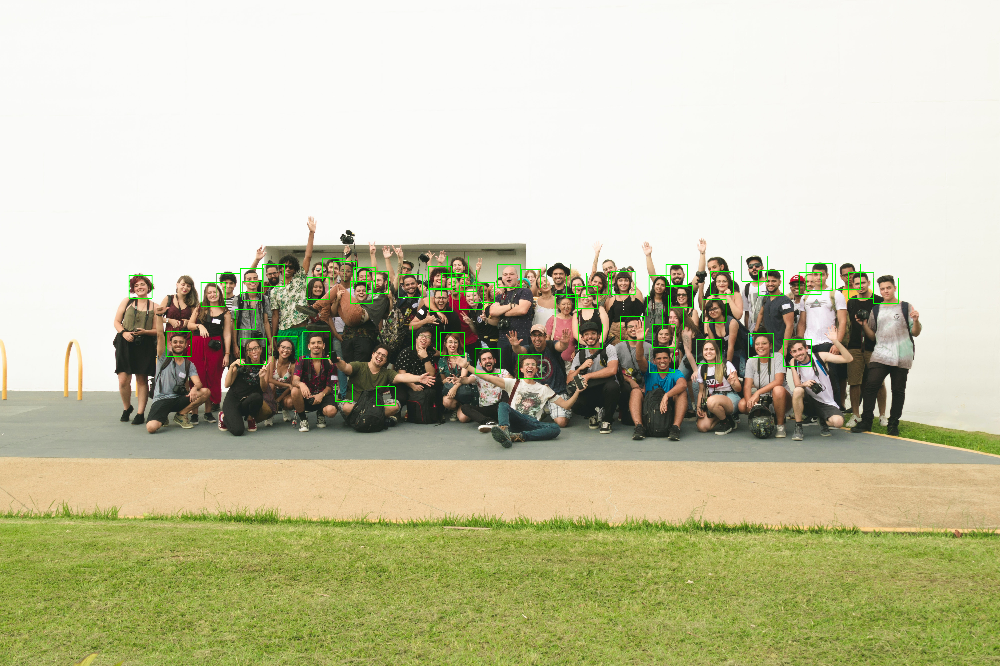

In [ ]:
faceCascade=cv2.CascadeClassifier("files/haarcascade_frontalface_default.xml");
#personImage=cv2.imread("images/person.jpg");
personImage=cv2.imread("images/group.jpg");

grayScalePersonImg=cv2.cvtColor(personImage,cv2.COLOR_BGR2GRAY);
faces=faceCascade.detectMultiScale(grayScalePersonImg,1.3,5);
for (x,y,w,h) in faces:
  cv2.rectangle(personImage,(x-25,y-25),(x+w+25,y+h+25),(0,255,0),3);
cv2_imshow(personImage);

### Exercise 3 - Shapes Detection

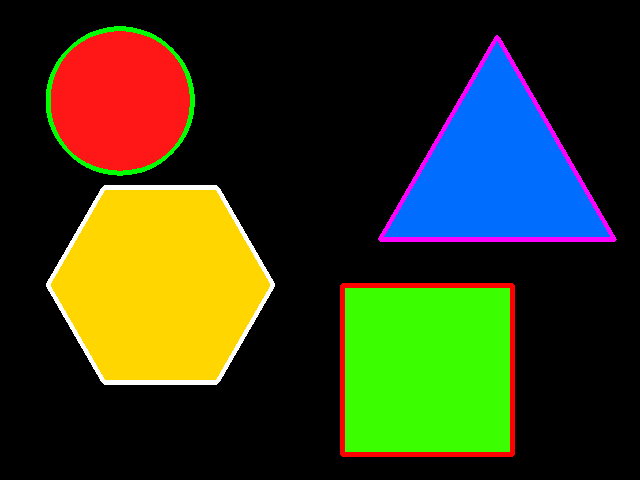

Number Of Shapes:  4


In [ ]:
numberOfShapes=0;
shapesImage=cv2.imread("images/shapes.png");
grayScaleImg=cv2.cvtColor(shapesImage,cv2.COLOR_BGR2GRAY);

# cv2.threshold(image,lowerBound,upperBound,type);
# cv2.threshold() return a tuple of image where all the focused part of image is
# black and background is white.
ret, shapesOnlyImage=cv2.threshold(grayScaleImg,50,255,1);
# cv2.findContours() takes a image and return contour lines in that image.
contourLine,h=cv2.findContours(grayScaleImg,1,2);
# Loop through all the contourLines and find the contour points
# With the help of contour points we can determine which shape is it.
# ie, a triangle has 3 contour points while a rectangle has 4.
for contourPoint in contourLine:
  # epsilon value is the amount of error which can be negated from the calculation.
  epsilon=cv2.arcLength(contourPoint,True);
  # cv2.approxPolyDP() takes contourPoints epsilon Value and isClosedCurve values
  # and return a smaller approximate contour point which just enough to specify
  # what shape was it.
  # cv2.approxPolyDP(contourPoint,epsilonValue,isClosedCurve)
  approxPoints=cv2.approxPolyDP(contourPoint,0.01*epsilon,True);
  points=len(approxPoints);
  numberOfShapes+=1;
  # cv2.drawCountours() takes the image, contourPoints, color, thickness and
  # draw line around that shape.
  # cv2.drawContours(image,[contourPoint],0,(b,g,r),thickness);
  if points==6:
    cv2.drawContours(shapesImage,[contourPoint],0,(255,255,255),4);
  elif points==4:
        cv2.drawContours(shapesImage,[contourPoint],0,(0,0,255),4);
  elif points==3:
        cv2.drawContours(shapesImage,[contourPoint],0,(255,0,255),4);
  elif points>6:
        cv2.drawContours(shapesImage,[contourPoint],0,(0,255,0),4);
  
cv2_imshow(shapesImage);
print("Number Of Shapes: ",numberOfShapes)


### Exercise 4 - Ball Tracking

In [8]:
ballCoor=[];
# cv2.VideoCapture take a file path and return the video
# cv2.VideoCapture("path");
inputVideo=cv2.VideoCapture("videos/video.mp4");# 0 for webcam
outputVideo=cv2.VideoWriter('output.avi',cv2.VideoWriter_fourcc('M','J','P','G'),10,(1920,1080));
# video.isOpened() return True if the video has any frames.
while video.isOpened():
  # video.read() read the video by frame and return a tuble with the frame as
  # an image and a True or False value, True if there is a frame.
  isFrame, frame = inputVideo.read();
  if isFrame is False:
    break;
  hsvBallFrame=cv2.cvtColor(frame,cv2.COLOR_BGR2HSV);
  # The ball is yellow colored
  lowerYellow=np.array([21,0,0]);
  upperYellow=np.array([45,255,255]);
  frameMask=cv2.inRange(hsvBallFrame,lowerYellow,upperYellow);
  contourLine,h=cv2.findContours(frameMask,cv2.RETR_TREE,cv2.CHAIN_APPROX_SIMPLE);
  centerContourPoint=None;
  if len(contourLine)>0:
    area=max(contourLine,key=cv2.contourArea);
    # cv2.minEnclosingCircle() take the focused area and return x,y coordinates
    # and it's radius.
    ((x,y),radius)=cv2.minEnclosingCircle(area);
    M=cv2.moments(area);
    try:
      centerContourPoint=(int(M["m10"]/M["m00"]),int(M["m01"]/M["m00"]));
      cv2.circle(frame,centerContourPoint,10,(255.255,255),-1);
      ballCoor.append(centerContourPoint);
    except:
      pass;
    if len(ballCoor)>2:
      for i in range(1,len(ballCoor)):
        cv2.line(frame,ballCoor[i-1],ballCoor[i],(0,0,255),3);
  outputVideo.write(frame);
outputVideo.release();


### Exercise 4 - Face Recognition

In [1]:
!git clone https://github.com/misbah4064/face_recognition.git
!pip install face_recognition
%cd face_recognition

Cloning into 'face_recognition'...
remote: Enumerating objects: 26, done.
remote: Counting objects: 100% (26/26), done.
remote: Compressing objects: 100% (24/24), done.
remote: Total 26 (delta 5), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (26/26), done.
     |████████████████████████████████| 100.2MB 51kB/s 
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566173 sha256=c619ba8d46e47ae0c77ca2db6a8f623c4017780af1d1eee899eef9d3006b856f
  Stored in directory: /root/.cache/pip/wheels/d2/99/18/59c6c8f01e39810415c0e63f5bede7d83dfb0ffc039865465f
Successfully built face-recognition-models
/content/face_recognition


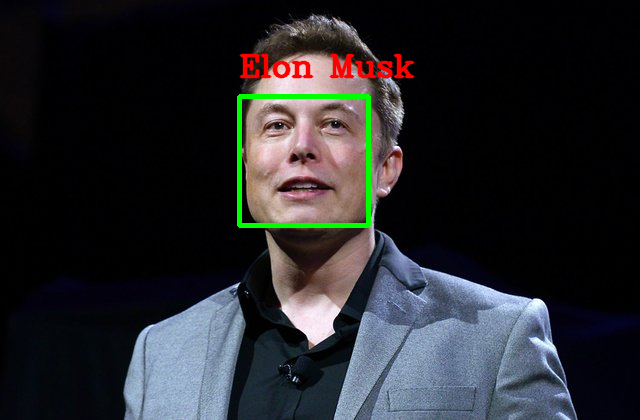

In [6]:
import face_recognition
import numpy as np
from google.colab.patches import cv2_imshow
import cv2

# Creating the encoding profiles
face_1=face_recognition.load_image_file("elon.jpg");
face_1_encoding=face_recognition.face_encodings(face_1)[0];

face_2=face_recognition.load_image_file("Donald Trump.jpg");
face_2_encoding=face_recognition.face_encodings(face_2)[0];

face_3=face_recognition.load_image_file("jeffbezos.jpg");
face_3_encoding=face_recognition.face_encodings(face_3)[0];

known_face_encodings=[
                     face_1_encoding,
                     face_2_encoding,
                     face_3_encoding,
]
known_face_names=[
                  "Elon Musk",
                  "Donald Trump",
                  "Jeff Bezos"
]

file_name ="unknown_el.jpg";
unknown_image = face_recognition.load_image_file(file_name);
unknown_image_to_draw=cv2.imread(file_name)
face_locations=face_recognition.face_locations(unknown_image);
face_encodings=face_recognition.face_encodings(unknown_image,face_locations);

for (top,right,bottom,left),face_encoding in zip(face_locations,face_encodings):
  matches=face_recognition.compare_faces(known_face_encodings,face_encoding);
  name= "Unknown"
  face_distances=face_recognition.face_distance(known_face_encodings,face_encoding)
  best_match_index=np.argmin(face_distances)
  if matches[best_match_index]:
    name=known_face_names[best_match_index]
  cv2.rectangle(unknown_image_to_draw,(left,top),(right,bottom),(0,255,0),3)
  cv2.putText(unknown_image_to_draw,name,(left,top-20),cv2.FONT_HERSHEY_COMPLEX,1,(0,0,255),2,cv2.LINE_AA);

cv2_imshow(unknown_image_to_draw)
